# ตอนที่ 1: การทดลองเตรียมข้อมูลและแสดงรายละเอียดข้อมูลเชิงกราฟ

1.1 Import Lib (numpy, pandas, matplotlib, sklearn, datetime)

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import model_selection
from sklearn import preprocessing
import seaborn as sns
import datetime as dt
from collections import defaultdict

1.2 โหลดข้อมูล MovieLens Dataset file (‘ratings.csv’, ‘movies.csv’, ‘tags.csv’) โดยใช้

In [2]:
data_rating = pd.read_csv('ml-latest-small/ratings.csv')
data_movies = pd.read_csv('ml-latest-small/movies.csv')
data_tags = pd.read_csv('ml-latest-small/tags.csv')
data = [data_rating,data_movies,data_tags]

In [3]:
def set_date(data):
    data['Date'] = pd.to_datetime(data['timestamp'],unit='s')
#     data.sort_values('Date', inplace=True)
set_date(data_rating)
set_date(data_tags)

In [4]:
print("size : ",len(data_rating))
data_rating.head()

size :  100836


,userId,movieId,rating,timestamp,Date
0,1,1,4.0,964982703,2000-07-30 18:45:03
1,1,3,4.0,964981247,2000-07-30 18:20:47
2,1,6,4.0,964982224,2000-07-30 18:37:04
3,1,47,5.0,964983815,2000-07-30 19:03:35
4,1,50,5.0,964982931,2000-07-30 18:48:51


In [5]:
print("size : ",len(data_movies))
data_movies.head()

size :  9742


,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [6]:

data_movies['year'] = data_movies['title'].str.split(" ")
data_movies['year'] = data_movies['year'].str[-1]
data_movies['year'] = data_movies['year'].str[-5:-1]
data_movies = data_movies[data_movies['year'].str.isdigit()].dropna()
data_movies

,movieId,title,genres,year
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995
2,3,Grumpier Old Men (1995),Comedy|Romance,1995
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,1995
4,5,Father of the Bride Part II (1995),Comedy,1995
...,...,...,...,...
9737,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy,2017
9738,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy,2017
9739,193585,Flint (2017),Drama,2017
9740,193587,Bungo Stray Dogs: Dead Apple (2018),Action|Animation,2018


In [7]:
print("size : ",len(data_tags))
data_tags.head()

size :  3683


,userId,movieId,tag,timestamp,Date
0,2,60756,funny,1445714994,2015-10-24 19:29:54
1,2,60756,Highly quotable,1445714996,2015-10-24 19:29:56
2,2,60756,will ferrell,1445714992,2015-10-24 19:29:52
3,2,89774,Boxing story,1445715207,2015-10-24 19:33:27
4,2,89774,MMA,1445715200,2015-10-24 19:33:20


1.3 Data Preprocessing

    1.3.1 Data Cleaning

In [8]:
for d in data:
    d = d.dropna()
    d = d.drop_duplicates()
data_rating[~data_rating['movieId'].isin(data_movies['movieId'])].dropna(inplace=True)
data_tags[~data_tags['movieId'].isin(data_movies['movieId'])].dropna(inplace=True)

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [9]:
print("data_rating size : ",len(data_rating))
print("data_movies size : ",len(data_movies))
print("data_tags size : ",len(data_tags))

data_rating size :  100836
data_movies size :  9719
data_tags size :  3683


    1.3.2 Data Preparation

        - เตรียมข้อมูล movie rating ด้วยการดึงข้อมูลปีคศ. (‘year’) จากข้อมูล UTC ‘timestamp’

In [10]:
data_rating['year'] = pd.DatetimeIndex(data_rating['Date']).year
data_rating

,userId,movieId,rating,timestamp,Date,year
0,1,1,4.0,964982703,2000-07-30 18:45:03,2000
1,1,3,4.0,964981247,2000-07-30 18:20:47,2000
2,1,6,4.0,964982224,2000-07-30 18:37:04,2000
3,1,47,5.0,964983815,2000-07-30 19:03:35,2000
4,1,50,5.0,964982931,2000-07-30 18:48:51,2000
...,...,...,...,...,...,...
100831,610,166534,4.0,1493848402,2017-05-03 21:53:22,2017
100832,610,168248,5.0,1493850091,2017-05-03 22:21:31,2017
100833,610,168250,5.0,1494273047,2017-05-08 19:50:47,2017
100834,610,168252,5.0,1493846352,2017-05-03 21:19:12,2017


        - เตรียมข้อมูล movie genre feature โดยกำหนดให้มีคอลัมน์ดังนี้โดยกำหนดให้ปรับรูปแบบ genres เป็น multi-label binarization

In [11]:
all_genres = []
mlb = preprocessing.MultiLabelBinarizer()

for _, row in data_movies.iterrows():
    all_genres.append(set(row.genres.split("|")))
data_genres = pd.DataFrame(mlb.fit_transform(all_genres),columns=mlb.classes_).fillna(0)

data_movies = pd.concat([data_movies,data_genres.reindex(data_movies.index)],axis=1)
data_movies = data_movies.rename(columns={"(no genres listed)":"No genres Listed"})
data_movies = data_movies.dropna()
data_movies


,movieId,title,genres,year,No genres Listed,Action,Adventure,Animation,Children,Comedy,...,Film-Noir,Horror,IMAX,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,0.0,0.0,1.0,1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3,Grumpier Old Men (1995),Comedy|Romance,1995,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,1995,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,5,Father of the Bride Part II (1995),Comedy,1995,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9714,188675,Dogman (2018),Crime|Drama,2018,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9715,188751,Mamma Mia: Here We Go Again! (2018),Comedy|Romance,2018,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9716,188797,Tag (2018),Comedy,2018,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9717,188833,The Man Who Killed Don Quixote (2018),Adventure|Comedy|Fantasy,2018,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


1.4 Data Visualization แสดงกราฟข้อมูลการเปลี่ยนแปลงของ movie genres และ movie rating ในแต่ละปี

    - กราฟที่ 1: แสดงกราฟค่า จำนวน released movies ในแต่ละปี

In [12]:
from itertools import cycle, islice

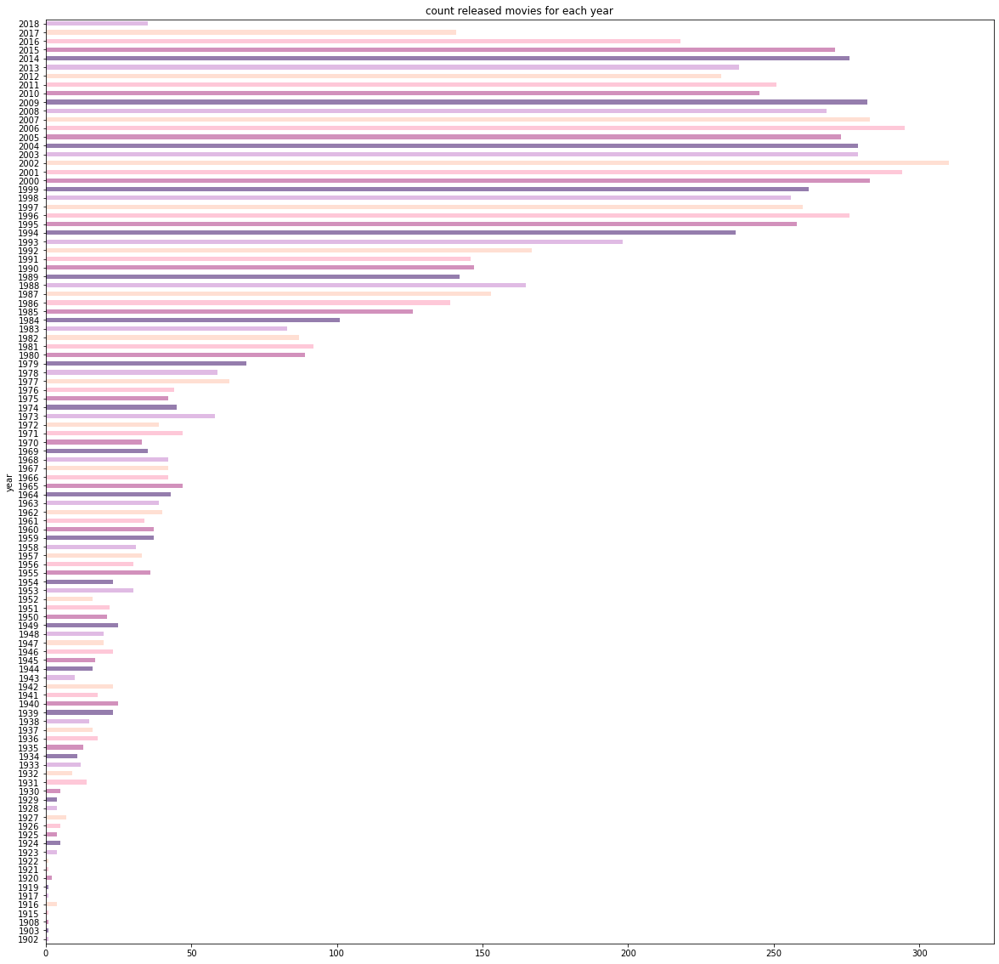

In [13]:
my_colors = list(islice(cycle(['#E0BBE4', '#957DAD', '#D291BC', '#FEC8D8', '#FFDFD3']), None, len(data_movies)))
# data_movies['year'].value_counts().plot(kind='barh',figsize=(30,30),color=my_colors)
data_movies.groupby('year')["year"].count().plot(kind='barh',figsize=(20,20),color=my_colors,title = 'count released movies for each year')

    - กราฟที่ 2: แสดงกราฟค่า จำนวนการให้ rating ในแต่ละปี

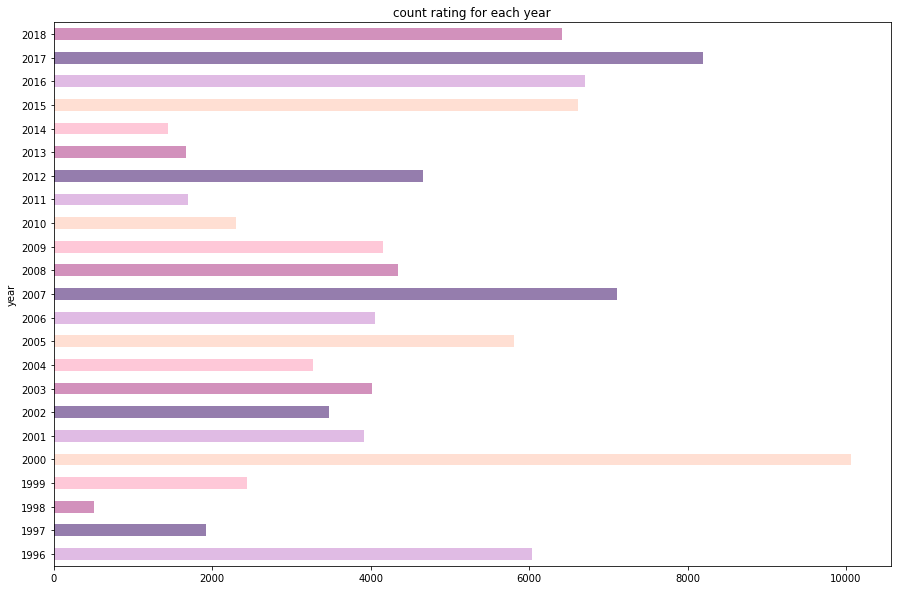

In [14]:
data_rating.groupby('year')["year"].count().plot(kind='barh',figsize=(15,10),color=my_colors,title = 'count rating for each year')

    - กราฟที่ 3: แสดงกราฟค่า จำนวน movies ในแต่ละ genre

C:\Users\beamconan\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:203: UserWarning: 'colors' is being deprecated. Please use 'color'instead of 'colors'
  "'colors' is being deprecated. Please use 'color'"


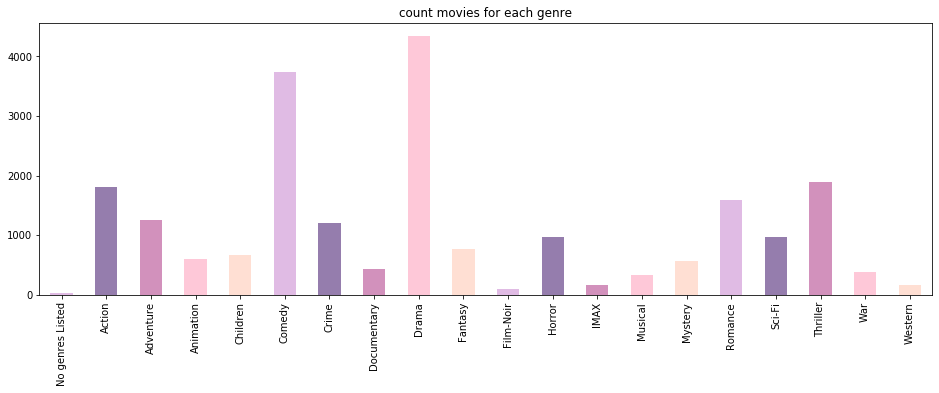

In [15]:
data_movies.sum(axis='rows').iloc[4:].plot(kind='bar',figsize=(16,5),colors=my_colors,title = 'count movies for each genre')

    - กราฟที่ 4: แสดงกราฟ (y-axis: stacked graph) ค่าจำนวน movie แต่ละ genre ในแต่ละปี (x-axis)

In [16]:
_data = pd.DataFrame(data_movies.groupby('year').sum().astype(np.int64),columns=data_movies.columns[4:])
_data

,No genres Listed,Action,Adventure,Animation,Children,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,IMAX,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
year,,,,,,,,,,,,,,,,,,,,
1902,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
1903,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1908,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1915,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
1916,0,1,0,0,0,1,2,0,1,0,0,0,0,0,2,1,0,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014,1,63,41,26,18,110,32,15,109,18,0,28,11,5,13,28,35,51,9,4
2015,6,59,44,34,20,116,26,17,82,26,1,31,0,0,18,17,45,44,4,3
2016,5,48,26,36,17,77,17,13,70,23,0,19,0,0,8,19,26,38,3,4


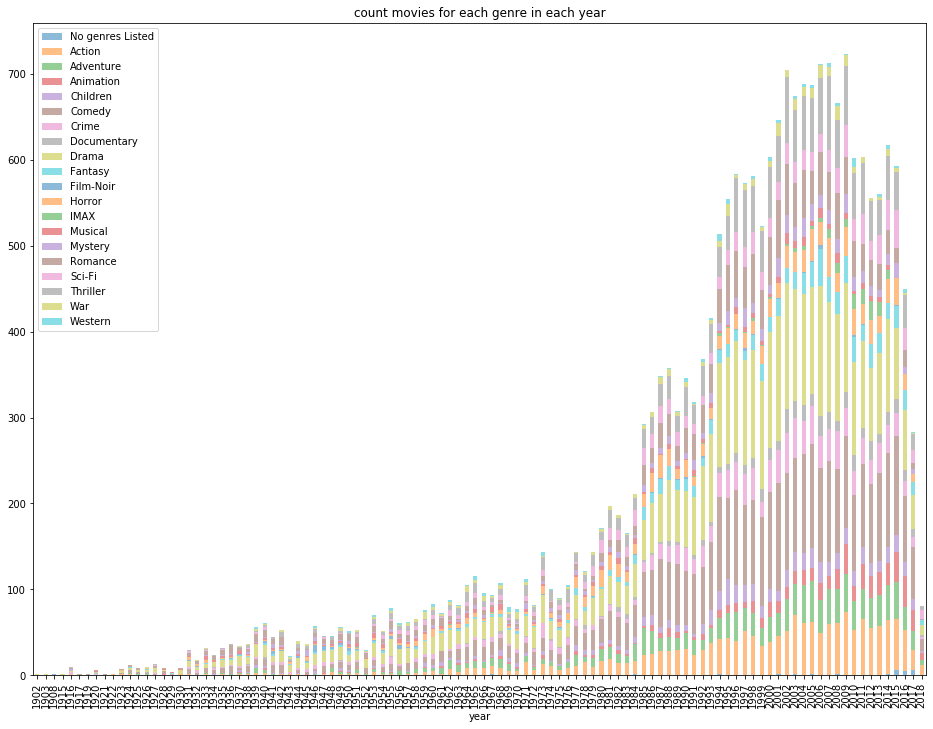

In [17]:
_data.plot(kind='bar',stacked = True,alpha = 0.5,figsize=(16,12),title = 'count movies for each genre in each year')

    - กราฟที่ 5: แสดงกราฟ Histogram ของการกระจายของค่าเฉลี่ย movie rating ใน dataset โดยค่าเฉลี่ย movie rating คำนวณจาก ค่า rating เฉลี่ยของแต่ละ movie เพื่อเป็นข้อมูล input ให้กับ histogram (โดยให้กำหนดจำนวน histogram bins ที่จะเห็นรายละเอียด)

In [18]:
_data = pd.DataFrame(data_rating.groupby('movieId').mean(),columns=['rating'])
_data = _data.reset_index()

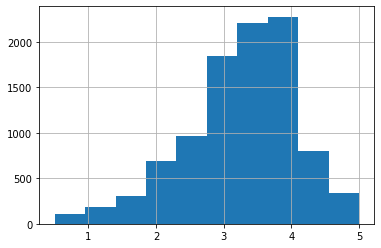

In [19]:
_data['rating'].hist(bins=10)

# ตอนที่ 4: การจัดกลุ่ม User ที่มีความชอบคล้ายกันด้วยเทคนิค k-mean และ Gaussian Mixture

In [20]:
from numpy.random import RandomState

4.1 สร้างข้อมูลความชอบของ user ตาม genre ของ movie ในรูปของ genre_rating_matrix

In [21]:
_data_rating = data_rating.loc[data_rating.rating>3.0,data_rating.columns[:3]].copy()
_data_rating = _data_rating.set_index('movieId')
_data_movies = data_movies.drop(columns=['title','genres','year'])
_data_movies = _data_movies.set_index('movieId')

In [22]:
df = pd.concat([_data_rating,_data_movies.reindex(_data_rating.index)],axis=1)
for g in df.columns[2:].values:
    df[g] = df[g]*df['rating']

df.replace(0,np.NaN,inplace=True)
df = df.groupby('userId').mean()
df.replace(np.NaN,0,inplace=True)
df

,rating,No genres Listed,Action,Adventure,Animation,Children,Comedy,Crime,Documentary,Drama,...,Film-Noir,Horror,IMAX,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
userId,,,,,,,,,,,,,,,,,,,,,
1,4.620000,0.00,4.578947,4.608108,4.814815,4.756757,4.542857,4.615385,0.000000,4.656250,...,5.000000,4.333333,0.000000,4.850000,4.846154,4.416667,4.531250,4.581395,4.650000,4.500000
2,4.260870,0.00,4.277778,4.500000,0.000000,4.000000,3.857143,3.833333,0.000000,4.357143,...,0.000000,3.500000,0.000000,0.000000,4.500000,4.375000,4.666667,4.400000,5.000000,0.000000
3,4.705882,0.00,4.650000,4.600000,0.000000,0.000000,5.000000,5.000000,0.000000,4.750000,...,0.000000,4.642857,0.000000,0.000000,5.000000,5.000000,4.791667,4.785714,0.000000,0.000000
4,4.500000,0.00,4.461538,4.526316,4.500000,4.428571,4.448276,4.555556,5.000000,4.442857,...,4.666667,4.250000,0.000000,4.500000,4.428571,4.586207,4.600000,4.590909,4.600000,4.428571
5,4.434783,0.00,4.000000,4.333333,4.600000,4.428571,4.285714,4.428571,0.000000,4.571429,...,0.000000,0.000000,5.000000,4.750000,4.000000,4.666667,0.000000,4.200000,4.500000,5.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
606,3.978923,0.00,3.994681,3.954545,4.053571,3.933333,4.011401,4.009259,3.833333,3.988496,...,3.928571,3.890244,3.785714,3.957143,4.028169,4.005747,3.975410,3.941558,4.020408,3.954545
607,4.468468,0.00,4.404762,4.450000,4.500000,4.666667,4.368421,4.500000,0.000000,4.491525,...,0.000000,4.666667,5.000000,5.000000,4.647059,4.384615,4.416667,4.553191,5.000000,4.000000
608,4.018473,0.00,3.993243,3.973118,3.913793,3.951613,3.976378,4.117347,3.800000,4.067251,...,5.000000,3.980392,4.214286,3.850000,4.023810,4.000000,4.035294,4.065359,4.050000,3.750000


4.2 สำหรับ K-mean model ให้กำหนดจำนวน n_cluster

In [23]:
from sklearn.cluster import KMeans
from sklearn import model_selection

In [24]:
# training set and validation set
seed = 42
X = np.array(df.iloc[:,1:])
_X_train, X_test = model_selection.train_test_split(X,test_size=0.33,random_state=seed)
X_train, X_validate = model_selection.train_test_split(_X_train,test_size=0.33,random_state=seed)

In [25]:
print("training set : ", X_train.shape)
print("validation set : ", X_validate.shape)
print("test set : ", X_test.shape)

training set :  (273, 20)
validation set :  (135, 20)
test set :  (201, 20)


In [26]:
n_clusters = [3,4,5,6,9,10,13]
kmeans_train = []
kmeans_predict_validate = []
kmeans_predict_test = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=42).fit(X_train)
    kmeans_train.append(kmeans)
    kmeans_predict_validate.append(kmeans.predict(X_validate))
    kmeans_predict_test.append(kmeans.predict(X_test))

In [27]:
centers= [kmeans_train[i].cluster_centers_ for i in range(len(n_clusters))]

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


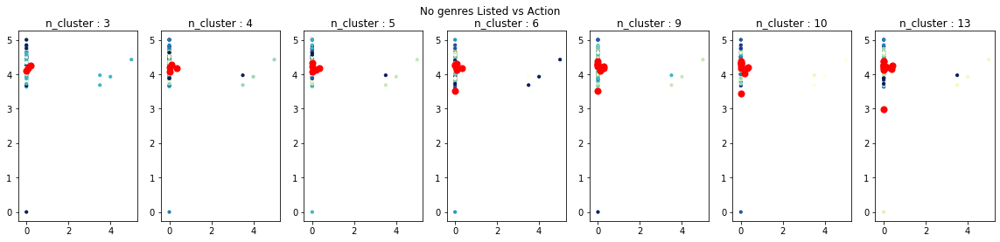

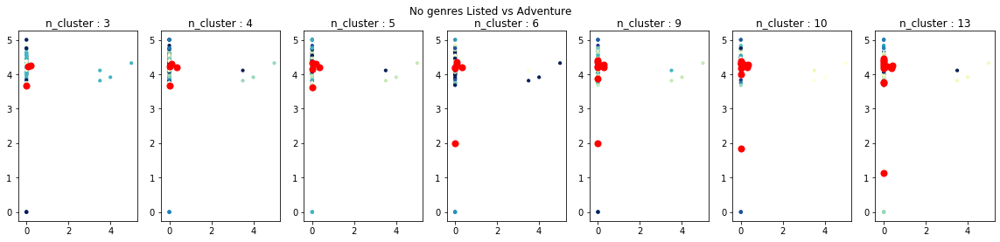

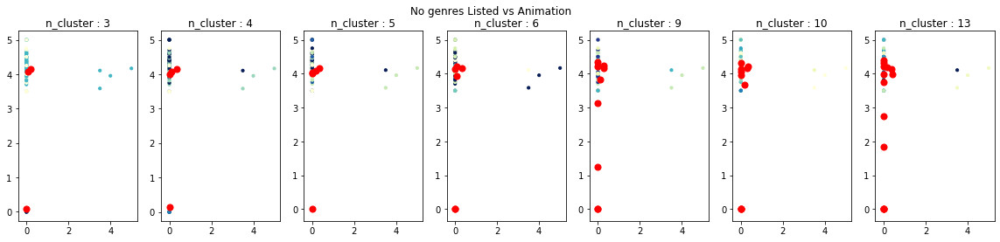

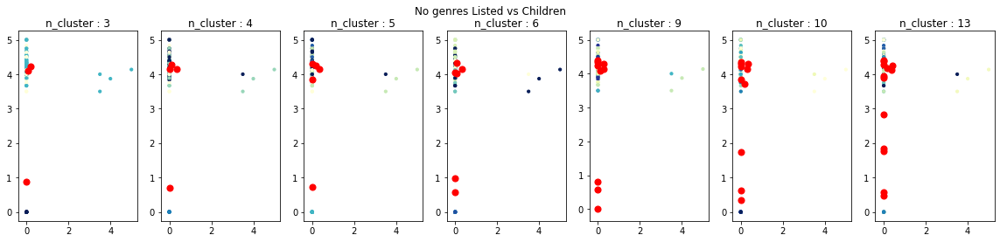

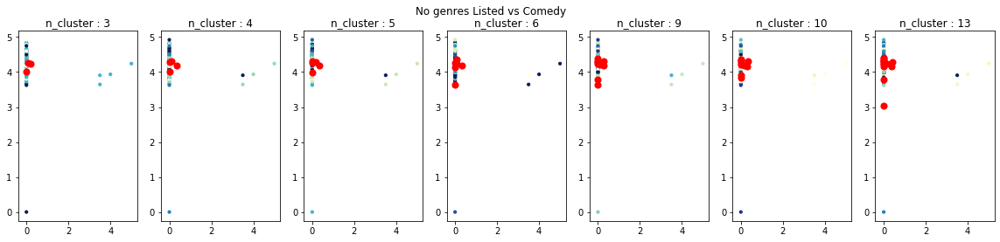

...

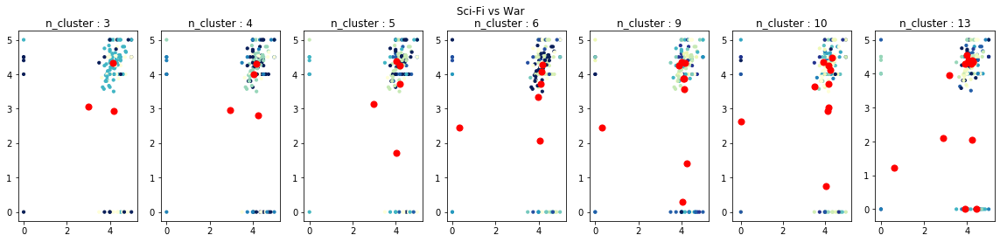

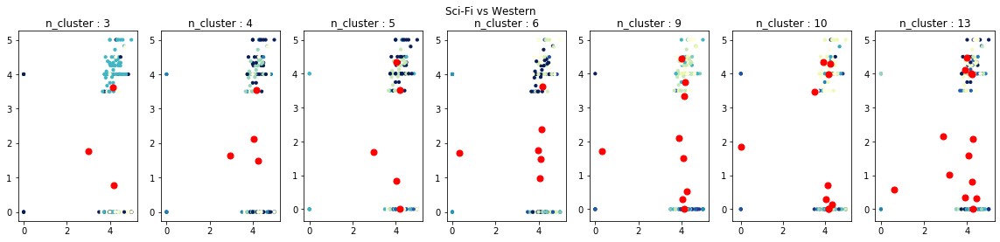

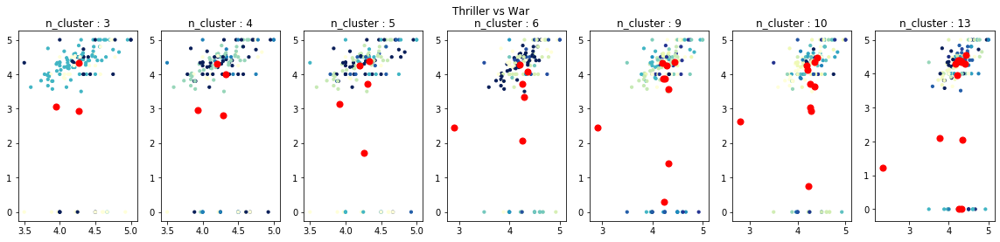

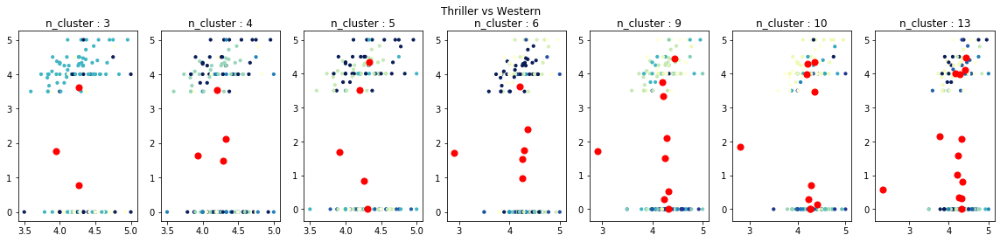

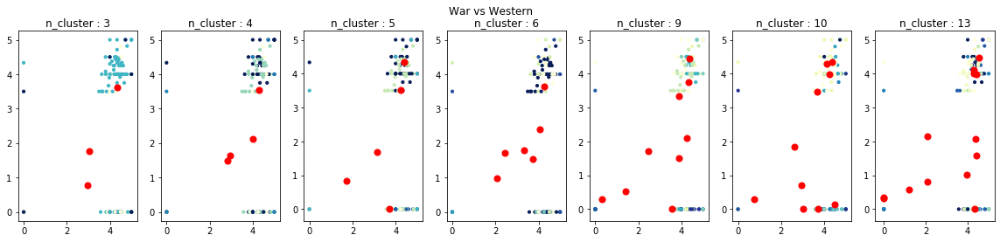

In [28]:
for i in range(20):
    for j in range(i+1,20):
        fig, ax = plt.subplots(1, len(n_clusters),figsize=(20,4))
        fig.suptitle(df.columns[1:][i]+' vs '+df.columns[1:][j])
        for n in range(len(n_clusters)):
            ax[n].set_title("n_cluster : "+str(n_clusters[n]))
            ax[n].scatter(X_validate[:,i], X_validate[:,j], c=kmeans_predict_validate[n], s=10,
                          cmap='YlGnBu')
            ax[n].scatter(centers[n][:, i], centers[n][:, j], c='red', s=50)

4.3 สำหรับ Gaussian Mixture Model

In [29]:
from sklearn.mixture import GaussianMixture
from matplotlib.patches import Ellipse

In [30]:
n_components = [3,4,5,6,9,10,13]
gmm_train = []
gmm_predict_validate = []
gmm_predict_test = []
for n in n_components:
    gmm = GaussianMixture(n_components=n, covariance_type='full' , random_state=42).fit(X_train)
    gmm_train.append(gmm)
    gmm_predict_validate.append(gmm.predict(X_validate))
    gmm_predict_test.append(gmm.predict(X_test))
    print('n_components : '+str(n))
    print('model mean : '+str(gmm.means_))
    print('model covariances : '+str(gmm.covariances_))
    print('model weights : '+str(gmm.weights_))
    print('-------------------------------------')

n_components : 3
model mean : [[0.         4.23118202 4.26278114 4.2117356  4.11424243 4.30908985
  4.13346067 1.26212274 4.34647306 3.99917667 0.43922773 2.93980127
  1.93595836 2.66539169 3.46225591 4.18386636 4.20774848 4.32141882
  3.02737819 1.42845349]
 [0.29257266 4.18930095 4.21669001 4.18979684 4.17876795 4.19852519
  4.25923948 2.94035777 4.24500507 4.25981745 2.67644895 4.14244368
  3.77381916 4.01267419 4.22443549 4.22097889 4.08470363 4.21060405
  4.32322626 3.16965127]
 [0.         4.1184775  3.71731109 0.         1.11440812 4.03095885
  3.75277003 0.47034097 4.30847321 2.29237356 0.93644015 3.06084731
  1.40254158 0.69830751 3.11018065 3.89476789 3.0652819  3.97949971
  3.1188668  1.88135487]]
model covariances : [[[ 1.00000000e-06  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 0.00000000e+00  2.58921912e-01  1.12358180e-02 ...  3.32046467e-02
    8.59010579e-02  1.36651821e-01]
  [ 0.00000000e+00  1.12358180e-02  2.77151705e-

In [35]:
def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height, 
                             angle, **kwargs))
        
def plot_gmm(gmm_model, X, col_id0, col_id1, label=True, ax=None):
    ax = ax or plt.gca()
    labels = gmm_model.fit(X).predict(X)
    if label:
        ax.scatter( X[:, col_id0], X[:, col_id1],c=labels, s= 10, cmap = 'YlGnBu', zorder=2)
    else:
        ax.scatter(X[:, col_id0], X[:, col_id1],s=10, zorder=2)
    ax.axis('equal')
    w_factor = 0.2 / gmm_model.weights_.max()
    for pos, covar, w in zip([gmm_model.means_[:,col_id0],gmm_model.means_[:,col_id1]], 
                             gmm_model.covariances_, 
                             gmm_model.weights_):
        covar = covar[[col_id0,col_id1],[col_id0,col_id1]]
        draw_ellipse(pos, covar, alpha=w * w_factor,ax=ax)

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\beamconan\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

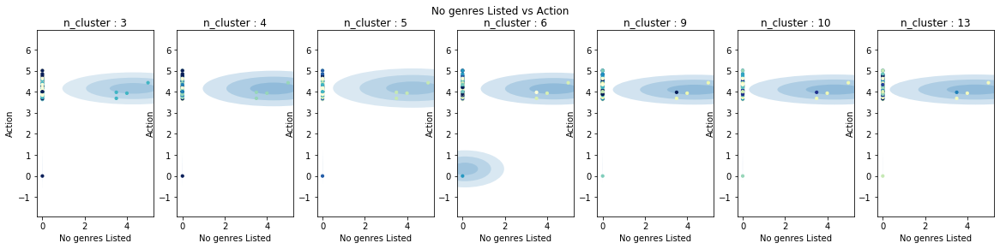

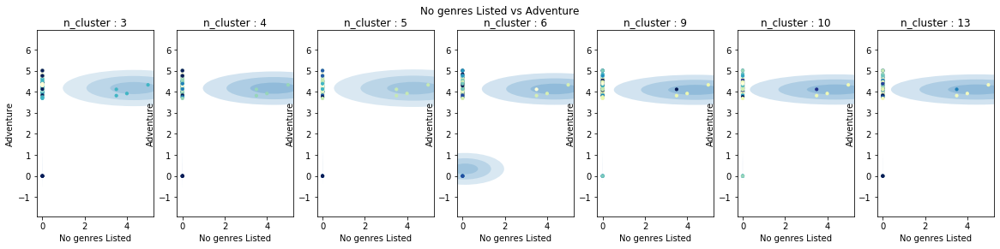

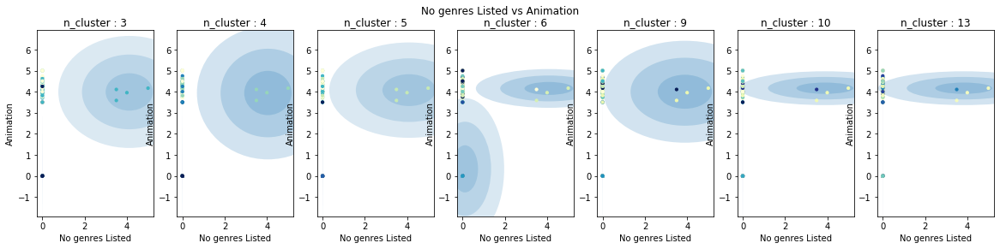

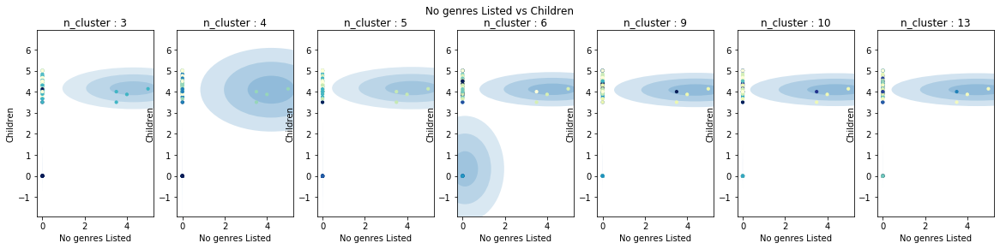

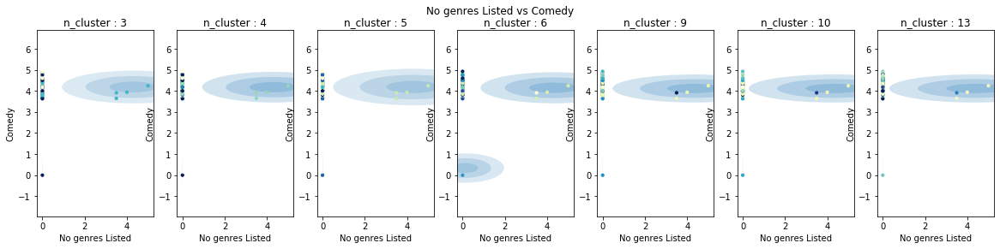

...

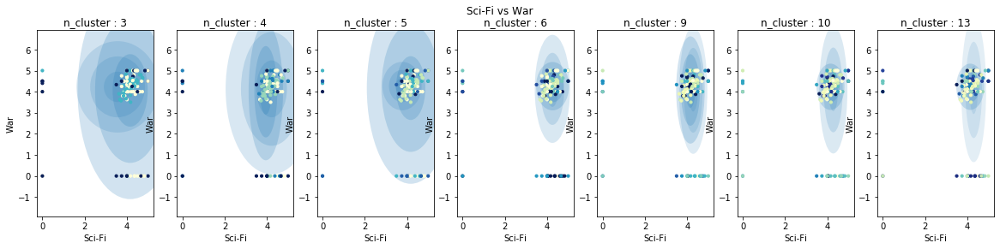

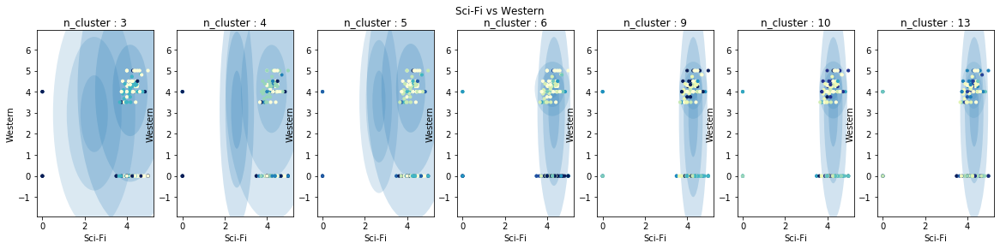

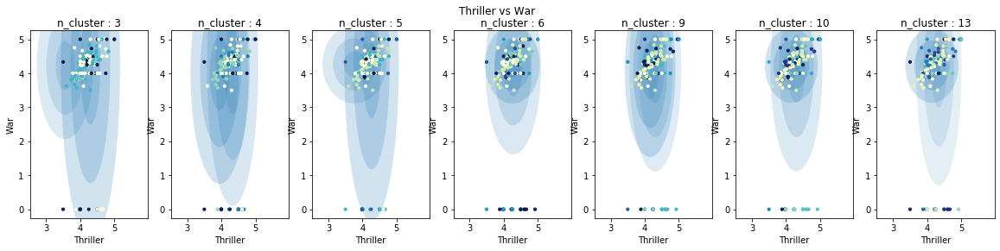

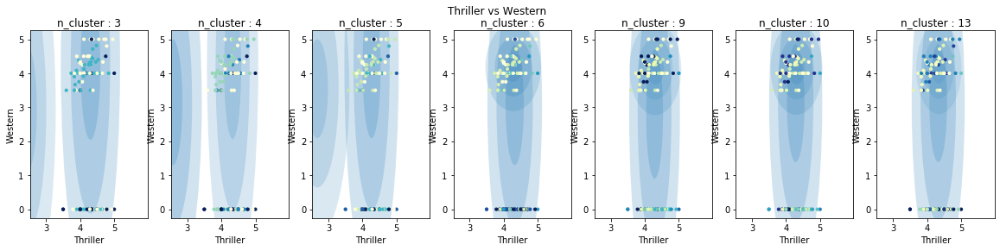

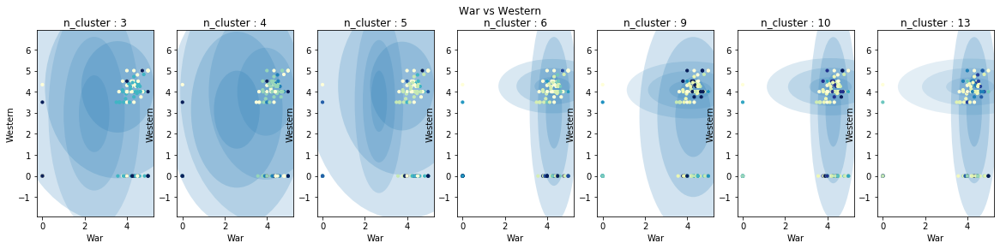

In [36]:
for i in range(20):
    for j in range(i+1,20):
        fig, ax = plt.subplots(1, len(n_clusters),figsize=(20,4))
        fig.suptitle(df.columns[1:][i]+' vs '+df.columns[1:][j])
        for n in range(len(n_clusters)):
            ax[n].set_title("n_cluster : "+str(n_clusters[n]))
            ax[n].set_xlabel(df.columns[1:][i])
            ax[n].set_ylabel(df.columns[1:][j])
            plot_gmm(gmm_model=gmm_train[n], 
                     X=X_validate,
                     col_id0=i,
                     col_id1=j,
                     ax=ax[n])